# Notebook Objective and Setup

BGG06 is where synthetic ratings are produced for each user, using the content-based item filter from BGG05.

## Package Imports

In [1]:
import pandas as pd
import numpy as np
import requests
import regex as re
import time
import os
import gc
import copy
import json
from statistics import mean

# ignore warnings (gets rid of Pandas copy warnings)
import warnings

warnings.filterwarnings("ignore")
pd.options.display.max_columns = None

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", 100)

# from scipy import sparse
# from scipy.sparse import csr_matrix
# from scipy import spatial

# from sklearn.metrics.pairwise import cosine_similarity
# import sklearn.preprocessing as pp
from sklearn.preprocessing import (
    MinMaxScaler,
)  # , OneHotEncoder, StandardScaler, PolynomialFeatures,

# visualization packages
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
import umap
import umap.plot

In [2]:
import tensorflow as tf
from tensorflow.compat.v1.losses import cosine_distance

## Notebook Functions

In [3]:
def produce_synthetic_ratings_all(user, num_ratings_create, game_ids):
    """
    Takes in a dictionary of user's ratings and the number of ratings to synthesize
    Synthesizes ratings and creates a dictionary of all synthesized ratings for the user
    Returns synthesized ratings

    Inputs:
    user: the user id to create ratings for
    temp_users_dictionary: dictionary of specific user's real ratings
    num_ratings_create : simple number. # Ratings to make in the run.

    Outputs:
    user_comps_dict : dictionary of synthesized ratings specifically for user
    """

    start = time.time()

    # print("Producing items for user")

    user_items = user_ratings[user]
    # user_mean = user_means[user]

    temp_users_dictionary = {}

    # copy the current user dictionary to a temp storage dictionary that we can manipulate

    for item in user_ratings[user]:
        item_mean = item_means[item]
        this_rating = round((user_ratings[user][item] - item_mean), 1)
        temp_users_dictionary[int(item)] = this_rating
        synthetic_users_dictionary[user][int(item)] = int(this_rating * 10)

    # get the original number of ratings by this user
    original_num_ratings = len(temp_users_dictionary)

    # start at iteration 0
    iteration = 0

    # set up dict to store all specific comps for this user
    users_comp_dict = {}

    # populate the comps with the user's baseline items
    for item in temp_users_dictionary:
        users_comp_dict[item] = [1, 1, item, 0, 0, temp_users_dictionary[item]]
        # overall confidence, this item similarity, item, iteration, degrees away, item name

    # while the list of items that the user rated is < the number of ratings needed:
    while len(temp_users_dictionary.keys()) < num_ratings_create:

        start_set_length = len(temp_users_dictionary.keys())

        users_rated_items = list(temp_users_dictionary.keys())
        # print(len(users_rated_items))

        iteration += 1  # advance the iteration

        # print("Starting iteration "+str(iteration))

        new_items = []  # make a list to hold the items for this iteration

        # for each rated item:
        for rated in users_rated_items:

            # print("Current item: "+str(rated))

            # get rating for current item
            rated_rating = temp_users_dictionary[rated]

            # get current best comp:
            current_position = 0
            current_comp = game_comps_byid_lookup[rated][0][current_position]

            while current_comp in new_items:

                # increment position
                current_position += 1

                if current_position >= 10000:
                    # print(current_position)
                    break

                else:
                    # reset current comp to new position new_items
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # any time the current comp is in users_rated_items already:
            while current_comp in temp_users_dictionary.keys():

                # increment position
                current_position += 1

                if current_position >= 10000:
                    # print(current_position)
                    break

                else:

                    # reset current comp to new position users_comp_dict
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # The next section activates once the current comp is not already in the user's rated items

            if current_position >= 10000:
                # print(current_position)
                break

            else:

                # getting similarity of the current comp
                comp_similarity = game_comps_byid_lookup[rated][1][current_position]

                # get the synthetic rating for the item by taking the rating of the base item * similarity
                synthetic_rating = round((rated_rating * comp_similarity), 1)

                # get the overall confidence of this rating
                # confidence = confidence of prior item * similarity of current item
                confidence = users_comp_dict[rated][0] * comp_similarity
                degrees = users_comp_dict[rated][4] + 1

                # add this item to the list of new items we are adding to the ratings this round
                new_items.append(current_comp)

                # make the user's comp dict
                users_comp_dict[current_comp] = [
                    confidence,
                    comp_similarity,
                    rated,
                    iteration,
                    degrees,
                    synthetic_rating,
                ]

                # update the temporary dictionary with the synthetic rating for the item
                temp_users_dictionary[current_comp] = synthetic_rating

                # add to synthetic users
                synthetic_users_dictionary[user][current_comp] = int(
                    synthetic_rating * 10
                )

        end_set_length = len(temp_users_dictionary.keys())

        if start_set_length == end_set_length:

            break

        continue

    end = time.time()
    # print(str(end-start)+' seconds for user.\n')

    return users_comp_dict, temp_users_dictionary

In [4]:
def sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
):
    """
    Takes the user's synthesized comps dict, the original number of ratings the user made,
    and the desired number of ratings the user needs.
    Creates a df sorting the synthesized ratings by confidence level,
    keeping the highest confidence if an item was recommended more than once.
    Evaluates number of ratings needed to reach 500 and keeps only that many ratings with the highest confidence.
    For each item kept, logs the synthetic rating to the user;s dictionary

    Inputs:
    user: specific user to sort
    synthetic_users_dictionary: reference to the dictionary of synthesized items
    user_comps_dict: dictionary of synthesized ratings specifically for user
    original_num_ratings: The number of ratings the user actually rated
    desired_ratings: the number of ratings needed by the user

    """

    # Use this one when you want only exactly x ratings and don't want to necessarily keep everything produced

    # showing synthetic ratings only
    user_comps_df = (
        pd.DataFrame(
            user_comps_dict.values(),
            index=user_comps_dict.keys(),
            columns=[
                "OverallConfidence",
                "SimtoLast",
                "RecFrom",
                "DegreesAway",
                "SyntheticRating",
            ],
        )
        .sort_values("OverallConfidence", ascending=False)
        .drop_duplicates(keep="first")
    )

    # get a list of the ratings to keep (past the real ratings)
    keep_items = list(user_comps_df[original_num_ratings:desired_ratings].index)

    # for each item that we keep,
    for item in keep_items:

        # add the rating to the real storage dictionary
        synthetic_users_dictionary[user][item] = user_comps_df.loc[item][
            "SyntheticRating"
        ]

In [5]:
def populate_all_ratings(user, synthetic_users_dictionary, temp_users_dictionary):
    """
    Takes the user's synthesized comps dict, the original number of ratings the user made,
    and the desired number of ratings the user needs.
    Creates a df sorting the synthesized ratings by confidence level,
    keeping the highest confidence if an item was recommended more than once.
    Evaluates number of ratings needed to reach 500 and keeps only that many ratings with the highest confidence.
    For each item kept, logs the synthetic rating to the user;s dictionary

    Inputs:
    user: specific user to sort
    synthetic_users_dictionary: reference to the dictionary of synthesized items
    user_comps_dict: dictionary of synthesized ratings specifically for user
    original_num_ratings: The number of ratings the user actually rated
    desired_ratings: the number of ratings needed by the user

    """

    not_rated = list(set(game_ids) - set(temp_users_dictionary.keys()))
    print(str(len(not_rated)) + " games were not rated")

    for item in not_rated:
        temp_users_dictionary[item] = 0
        users_comp_dict[item] = [0, 0, 0, iteration, 0, 0]

    print("End length of rated items is " + str(len(temp_users_dictionary)))

    # get a list of the ratings to keep (past the real ratings)
    keep_items = sorted(list(temp_users_dictionary.keys()))

    # for each item that we keep,
    for item in keep_items:

        # add the rating to the real storage dictionary
        synthetic_users_dictionary[user][item] = temp_users_dictionary[item]

## Required Data Load

In [6]:
# read games for game_ids
games = pd.read_pickle("data_store/data_cleaned/games.pkl")
game_ids = list(games["BGGId"])

In [7]:
# Read cosine similarity pickle
sims_byid = pd.read_pickle("data_store/data_cleaned/game_cosine_similarity_byid.pkl")

In [8]:
# Opening JSON file
with open("data_store/data_cleaned/item_means.json") as json_file:
    item_means = json.load(json_file)

In [9]:
# Opening JSON file
with open("real_ratings/real_user_ratings_unscaled.json") as json_file:
    user_ratings = json.load(json_file)

all_users = list(user_ratings.keys())

user_block_1 = all_users[:40000]
user_block_2 = all_users[40000:80000]
user_block_3 = all_users[80000:120000]
user_block_4 = all_users[120000:160000]
user_block_5 = all_users[160000:200000]
user_block_6 = all_users[200000:240000]
user_block_7 = all_users[240000:]

user_blocks = [
    user_block_1,
    user_block_2,
    user_block_3,
    user_block_4,
    user_block_5,
    user_block_6,
    user_block_7,
]

# del user_ratings
# gc.collect()

In [10]:
# dictionary of game IDs-Names

# Load games
games = pd.read_pickle("data_store/data_cleaned/games.pkl")

# lists of game ids and game names
game_ids = list(games["BGGId"])
game_names = list(games["Name"])

# make lookup dictionary
game_id_lookup = {}

# store ids and names in lookup dictionary
for key, item in zip(game_ids, game_names):
    game_id_lookup[key] = item


del games
gc.collect()

882

In [11]:
len(game_id_lookup)

21925

In [12]:
# get top 1000 most similar games for each game and store in dictionary

game_comps_byid_lookup = {}

for item in sims_byid.columns:
    results = pd.DataFrame(
        data={"Similarity": sims_byid[item].sort_values(ascending=False)[1:]}
    )
    current_cap = results["Similarity"].max()
    comps_index = list(results[:10000].index.astype("int32"))
    comps_similarity = list(results[:10000]["Similarity"])
    game_comps_byid_lookup[item] = [comps_index, comps_similarity]

In [13]:
del sims_byid
gc.collect()

21

# Produce Synthetic Ratings

## Test One User

In [15]:
with open("real_ratings/user_ratings_block_unscaled_2.json") as json_file:
    user_ratings = json.load(json_file)

In [16]:
user_ratings["Threnody"]

{'25190': 6.0,
 '13': 6.0,
 '3076': 6.0,
 '822': 7.0,
 '68448': 7.5,
 '2651': 6.0,
 '30549': 8.0,
 '31260': 7.0,
 '14996': 7.0,
 '266192': 7.0,
 '110327': 7.0,
 '9209': 7.0,
 '70323': 7.0,
 '36218': 8.0,
 '28143': 7.0,
 '34635': 7.0,
 '178900': 8.0,
 '237182': 7.0,
 '162886': 7.0,
 '167791': 9.0,
 '98778': 7.0,
 '320': 4.0,
 '201808': 7.0,
 '41114': 7.0,
 '230802': 8.0,
 '124361': 7.5,
 '18602': 7.0,
 '157354': 7.5,
 '169786': 9.0,
 '148228': 8.0,
 '65244': 7.0,
 '1406': 3.0,
 '157969': 7.0,
 '170216': 8.0,
 '146508': 6.5,
 '37111': 8.0,
 '129622': 8.0,
 '224517': 8.0,
 '50': 7.0,
 '10547': 7.0,
 '478': 7.5,
 '11': 7.0,
 '40834': 8.0,
 '3955': 6.0,
 '118': 6.0,
 '199792': 8.0,
 '291457': 8.0,
 '27162': 7.0,
 '50381': 6.0,
 '2453': 7.0,
 '192291': 7.5,
 '3': 6.0,
 '233867': 7.5,
 '218603': 7.0,
 '43443': 6.0,
 '172818': 6.5,
 '1294': 5.0,
 '124708': 7.0,
 '182028': 9.0,
 '244521': 8.0,
 '239188': 7.5,
 '182874': 7.5,
 '37046': 7.5,
 '148949': 8.0,
 '102652': 7.0,
 '131357': 8.0,
 '21951

In [17]:
user = "Threnody"

In [26]:
this_user = pd.DataFrame(user_ratings[user].values(), index=user_ratings[user].keys())
this_user.reset_index(inplace=True)
this_user.rename(columns={0: "Rating", "index": "BGGId"}, inplace=True)
this_user["Game"] = this_user["BGGId"].astype("int32").map(game_id_lookup)
this_user.sort_values("Rating", ascending=False).head(30)

,BGGId,Rating,Game
156,463,10.0,Magic: The Gathering
157,168435,10.0,Between Two Cities
150,174430,10.0,Gloomhaven
154,171668,10.0,The Grizzled
155,163166,10.0,One Night Ultimate Werewolf: Daybreak
138,284083,10.0,The Crew: The Quest for Planet Nine
90,161936,10.0,Pandemic Legacy: Season 1
135,84876,10.0,The Castles of Burgundy
143,221107,10.0,Pandemic Legacy: Season 2
148,147949,10.0,One Night Ultimate Werewolf


In [19]:
# number of synthetic ratings to produce
num_ratings_create = 250

# number of ratings we will end up using
# desired_ratings = 250

In [20]:
# set up a synthetic ratings dictionary to store the users and ratings
synthetic_users_dictionary = {}
synthetic_users_dictionary[user] = {}

In [23]:
print("Starting user " + user)

# call function to produce synthetic ratings
user_comps_dict, temp_users_dictionary = produce_synthetic_ratings_all(
    user, num_ratings_create, game_ids
)

Starting user Threnody


In [24]:
temp2 = pd.DataFrame(
    synthetic_users_dictionary[user].values(),
    index=synthetic_users_dictionary[user].keys(),
)
temp2["Game"] = temp2.index.map(game_id_lookup)
temp2["Rating"] = temp2[0] / 10  # +user_mean
temp2.reset_index(inplace=True)
temp2.drop(["index", 0], axis=1, inplace=True)
temp2.sort_values("Rating", ascending=False).head(100)

,Game,Rating
157,Between Two Cities,3.1
154,The Grizzled,2.9
148,One Night Ultimate Werewolf,2.9
335,Mū,2.9
326,One Night Ultimate Vampire,2.8
155,One Night Ultimate Werewolf: Daybreak,2.7
332,The Grizzled: Armistice Edition,2.7
333,One Night Ultimate Alien,2.5
153,Roll Player,2.5
156,Magic: The Gathering,2.4


In [27]:
user_comps_df = (
    pd.DataFrame(
        user_comps_dict.values(),
        index=user_comps_dict.keys(),
        columns=[
            "OverallConfidence",
            "SimtoLast",
            "RecFrom",
            "Iteration",
            "DegreesAway",
            "SyntheticRating",
        ],
    )
    .sort_values("OverallConfidence", ascending=False)
    .drop_duplicates(keep="first")
)

user_comps_df["SyntheticRating"] = user_comps_df["SyntheticRating"]  # +user_mean
user_comps_df["RecommendedItem"] = user_comps_df.index.map(game_id_lookup)
user_comps_df["Seed"] = user_comps_df["RecFrom"].map(game_id_lookup)
user_comps_df.sort_values("SyntheticRating", ascending=False).head(30)

,OverallConfidence,SimtoLast,RecFrom,Iteration,DegreesAway,SyntheticRating,RecommendedItem,Seed
168435,1.00,1.00,168435,0,0,3.1,Between Two Cities,Between Two Cities
269145,0.93,0.93,168435,1,1,2.9,Mū,Between Two Cities
171668,1.00,1.00,171668,0,0,2.9,The Grizzled,The Grizzled
147949,1.00,1.00,147949,0,0,2.9,One Night Ultimate Werewolf,One Night Ultimate Werewolf
180956,0.95,0.95,147949,1,1,2.8,One Night Ultimate Vampire,One Night Ultimate Werewolf
231327,0.94,0.94,171668,1,1,2.7,The Grizzled: Armistice Edition,The Grizzled
163166,1.00,1.00,163166,0,0,2.7,One Night Ultimate Werewolf: Daybreak,One Night Ultimate Werewolf: Daybreak
204431,0.94,0.94,163166,1,1,2.5,One Night Ultimate Alien,One Night Ultimate Werewolf: Daybreak
169426,1.00,1.00,169426,0,0,2.5,Roll Player,Roll Player
9200,0.95,0.95,169426,1,1,2.4,Heroes Incorporated,Roll Player


In [28]:
user_comps_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 356 entries, 25190 to 173784
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   OverallConfidence  356 non-null    float64
 1   SimtoLast          356 non-null    float64
 2   RecFrom            356 non-null    int64  
 3   Iteration          356 non-null    int64  
 4   DegreesAway        356 non-null    int64  
 5   SyntheticRating    356 non-null    float64
 6   RecommendedItem    356 non-null    object 
 7   Seed               356 non-null    object 
dtypes: float64(3), int64(3), object(2)
memory usage: 25.0+ KB


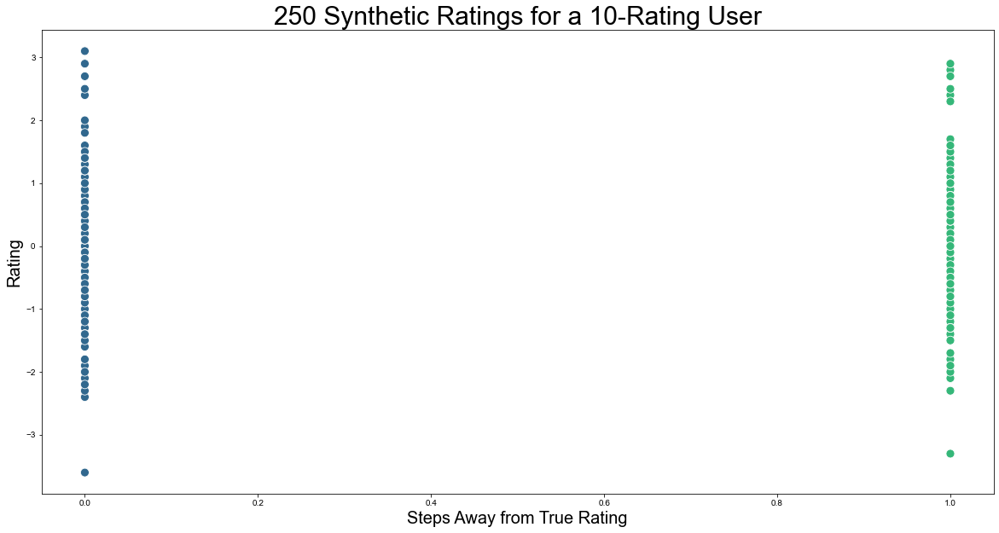

''

In [29]:
fig, ax = plt.subplots(figsize=(20, 10))

sns.set(font_scale=1.5)  # set our font scale bigger for this vis

# scatter our data
sns.set_style("darkgrid")
scatter2 = sns.scatterplot(
    x="DegreesAway",
    y="SyntheticRating",
    data=user_comps_df,
    hue="DegreesAway",
    palette="viridis",
    s=100,
)
# ax.axhline(user_mean)
# ax.text(x=.5, y=(user_mean+.2), s='User Mean '+str(user_mean), alpha=0.7, color='black')

ax.get_legend().remove()

plt.title(str(desired_ratings) + " Synthetic Ratings for a 10-Rating User", fontsize=30)
plt.xlabel("Steps Away from True Rating", fontsize=20)
plt.ylabel("Rating", fontsize=20)


plt.tight_layout
# plt.savefig('images/synthetic_from10.png')
plt.show();

In [30]:
del synthetic_users_dictionary
del user_comps_df
del temp_users_dictionary
del this_user
del user_ratings
del user_comps_dict

gc.collect()

393

## Process ALL Users

Specify number of synthetic ratings to produce, as well as target paths to save files.

In [14]:
# number of synthetic ratings to produce
num_ratings_create = 1000

# number of ratings we will end up using
# desired_ratings = 250

open_block = "real_ratings/real_user_ratings_unscaled"  # base file to open and synthesize ratings
save_block = (
    "synthetic_ratings/users_synthetic_" + str(num_ratings_create) + "_"
)  # save path for synthesized
matrix_save = (
    "synthetic_ratings/users_synthetic_" + str(num_ratings_create) + "_fullmatrix.pkl"
)  # save path for full matrix

In [15]:
block_marker = 0

for block in user_blocks:

    print(block)
    block_marker += 1

    # Opening JSON file
    with open(open_block + str(block_marker) + ".json") as json_file:
        user_ratings = json.load(json_file)

    # set up a synthetic ratings dictionary to store the users and ratings
    synthetic_users_dictionary = {}

    user_count = 0

    for user in block:
        # print(user)
        user_count += 1

        synthetic_users_dictionary[user] = {}

        # print("Starting user "+str(user_count))

        # call function to produce synthetic ratings
        user_comps_dict, temp_users_dictionary = produce_synthetic_ratings_all(
            user, num_ratings_create, game_ids
        )

        # sort_synthetic_ratings(user, synthetic_users_dictionary, temp_users_dictionary)

        del user_comps_dict
        del temp_users_dictionary
        # gc.collect()

    # save dictionary
    with open(save_block + str(block_marker) + ".json", "w") as convert_file:
        convert_file.write(json.dumps(synthetic_users_dictionary))

    del synthetic_users_dictionary
    gc.collect()

['Tonydorrf', 'tachyon14k', 'Ungotter', 'brainlocki3', 'PPMP', 'Dychotimer', 'BioNighty', 'htwongah', 'CunningLinguist78', 'Jimmy_Jamz', 'Kartigan', 'Fmoran94', 'Mark1130', 'Joel2014', 'Narstrand', 'EnrichedStarGuts', 'cmicha', 'silentxsound', 'dontylw', 'Polono', 'Josefam23', 'm1hune2007', 'LakerChief67', 'Adidas02', 'lemados', 'Pumpkinhead76', 'projectmoonlightcafe', 'bassgonist', 'SpaceAlien', 'stormseeker75', 'deerslurpee', 'Mairus', 'kezcade', 'vdwoord', 'Paletius', 'GenomeHelix', '3villans', 'Rhes', 'yoshy_33', 'Scaramanga1965', 'cycyx', 'crucial_velocity', 'pluvia33', 'Acward', 'mccar85', 'hatbeard', 'sven8705', 'Chunkmonger', 'notjux', 'Larnth', 'thrake', 'Jades09', 'BuddasMammoth', 'DurangoExile', 'DangerGeek85', 'crynyd', 'gator_ja', 'Reuner', 'FlussBurrito', 'cygnuscrux', 'bigwig30', 'waltermac', 'Moncalf', 'JonnyKage', 'leo707', 'AzraelAsylum', 'jedipanda', 'Dave41fan', 'margrabius', 'wafflebun', 'OGRussHood', 'weidox', 'himokl', 'hyc4089', 'MYKERAN1965', 'Narfbuster', 'Met

['kn0r', 'randomcamel', 'nehilism', 'ohsam', 'elizaw', 'MikefromWVa', 'WhiteLocust', 'napkeeper', 'ryanpschneider', 'WindSoul', 'dcoe', 'gecko235', 'eateng300', 'Greykin', 'borygex', 'AndersonCouncil', 'fdevans', 'irkenInvader', 'Admiral_Discomfort', 'Kisco', 'bsgaddict', 'BEevoLI', 'outofnapkins', 'Elektra12', 'oopstoons', 'scottiedragon88', 'fiddly_bits', 'TRONOFTHEDEAD', 'mauigreen', 'Sail4Horizon', 'bobthetomato1', 'Dwabi', 'kamicrzy', 'charlie_en', 'Mortazel', '1nf1n1ty', 'awoodf01', 'virus1967', 'nwloka', 'e_nugo', 'nilswloka', 'egoodwintx', 'Nimba', 'Narval7', 'DeSangre', 'simenvdb', 'Tuari', 'Murkxsi', 'sheik', 's0915579408', 'ethan201', 'OneManXXXX', 'CleoHsu', 'datafok', 'sydstar', 'hokuto_su', 'dick0791', 'hum3hum3', 'derder0129', 'Palmerex', 'Darasu', 'agricolafarm', 'conan51', 'lobin', 'wangyiqun2vio', 'nalter', 'corycat75', 'nicocon', 'TWisely', 'flow wong', 'watertank10430', 'jackuly', 'tonichan', 'imjazyblue', 'jerrywongcy', 'damianwong', 'awon123', 'dran', 'hihimorton'

['Nichiyoubi', 'Narne', 'Mattsaku', 'Teeguru87', 'Gardreth', 'RicardoGomes', 'venturaslb', 'Bigornas', 'meeplove', 'RicardoViegas', 'ajogar', 'LarisaZ', 'rmscouto', 'Begowatt', 'pendragon_76', 'ynaca', 'shylikehxc', 'Gieve', 'Thaerlbone', 'HappyKoala84', 'Moi!', 'amroth007', 'Kenogui', 'Indianapolis76', 'Beetz21', 'Blakemortimer74', 'hdb07', 'fxndndg', 'brazashista', 'Stekkos', 'Paluin_hloke', 'Sanktjean', 'mikepmosh', 'Garko', 'Viledurum', 'MadTotoro', 'Kerza', 'Co1980', 'Nelis71', 'nathelbiya', 'tomtsya', 'Xandaresch', 'silver gull', 'wardeverson1986', 'tanukibetsy', 'FoxdaleGames', 'TheNewbie', 'mark_c', 'jk10h', 'Salinisation', 'UUFCC', 'Jhonyb', 'adrienned1', 'lttully', 'Plugger59', 'TheNewblet', 'Erduplou', 'Quotidian007', 'disenor', 'Nittanneey', 'seoism', 'Samustroid', 'merikari', 'Kibiras', 'QuirkyCookie', 'lemmingway', 'abedini168', 'Angelochek', 'Ode-b', 'Pietari', 'MakeH', 'feffi', 'ardour', 'Clawf1ng3r', 'leibgeber', 'MasiKON', 'allumbra', 'Asuragogo', 'Mosaik Atelier', 'M

['dreamfinder17', 'Masterblaster11', 'ScooterMcgree', 'Lemons3', 'xinzhoo', 'trojasmic', 'mikeymischief', 'mjmills0', 'Celtics418', 'Cheerdiesel526', 'Borelaxdota', 'Kay0102', 'MMGrizzly', 'simpsonps121', 'RossToss', 'archerhawke', 'Da Senzai', 'destiin', 'heathandliz', 'Darkmancer', 'Tombombadil116', 'Art Campbell', 'abbottusma', 'kawatk04', 'Astrella', 'KMWs', 'Kr4mp3', 'enebriated', 'Red Hand SMITE', 'HoneysuckleGames', 'Craig300983', 'DoraC', 'iron_n_wine', 'slatey', 'princasspete', 'thebigbadbears', 'UnanimousAnonymity', 'Draddict', 'jtollervey', 'hershmeister', 'ruggermike', 'Chris Sycamore', 'Askanon', 'Fumonkey', 'Cosworth', 'sdjmred', 'leeannemccoy', 'Manta1001', 'doc_cthulhu', 'Dognight', 'merguitur', 'ilcapokan', 'Setau', 'Atharel', 'Ekalian', 'Cer3bix', 'amena60', 'skipmc', 'WebKoala', 'Spellenhuis Haarlem', 'vetsurg', 'Lunalol', 'Jojje79', 'Jim Williams', 'Janus89', 'JayPudding', 'Der Luso', 'irvancode', 'orion66', 'Livaet', 'htony', 'Klysan', 'stormbirdd', 'pentagarn', 'f

['cassandranc', 'oldfamiliarscene', 'jerrylinew', 'Gimplet', 'splocki', 'Wakus', 'Dahl', 'spiritzero', 'MrLussier', 'pingzuojiangjun', 'Zzypster', 'glende', 'ryro717', 'MS_Virus', 'Cercatoro', 'techchick23', 'captcrunch227', 'Willebrand', 'ImiroI', 'Crell', 'Jimmy_Needles', 'aceline82', 'meatp', 'Deckard 999', 'jribenfors', 'StewingPanda', 'Ccast291', 'Allls', 'Youronas', 'snappox', 'Edagimo', 'HON_BG', 'pianoman5000', 'jgrobts', 'DonovanReeves', 'MrRadikal', 'Wildman0326', 'naomielizak', 'jeffcox91', 'bio23', 'GreatAngoosian', 'squaresbear', 'superplusgood', 'HexAddict', 'xRen1101', 'eddyd83', 'JiG_SaW', 'Shanagar', 'ijsantos2005', 'yugi532', 'cmoe25027', 'JurgenVeliki', 'dicksokg', 'hma319', 'ratuntamc', 'mintroyal', 'daringerow', 'brutemong', 'egingrich83', 'Tylersnotes', 'Xelto', 'amorstyx', 'galathrax1', 'igor_f', 'cublikefoot', 'Lindamariie', 'rjm5001', 'DingDongDinge', 'Stupidknome', 'Scottyblitz', 'almond_jester', 'MisterrrScott', 'Lord_Vaprak', 'SallyDan', 'Klenszarka', 'Rafsz

['jiojio', 'ashpash', 'horsedeer', 'Noldor130884', 'yomilk', 'mbc80', 'desertfox14', 'lordbear', 'Sarah_tyme', 'rpanesar', 'fwkruger', 'Grakulla', 'AHumphrey5777', 'Ashuccino', 'khanw209', 'DonkeyKonga', 'sevengek0', 'artemis2029', 'jordanpaok', 'XavierRA', 'st0fr', 'Nait79', 'Neogranzon', 'jehnnycash', 'Clangorac2013', 'captaintragedy', 'JanDeRoos', 'goldengriffin', 'leleguns', 'memer', 'Sacubas13', 'Fede3751', 'Parrado', 'Mrjapr', 'Sedai', 'Yurang', 'AnnabelleD', 'AnitaDr', 'bdirwyn', 'Oh Snap', 'GregBarry', 'twotwozombie', 'kossa', 'benlichtenwald', 'TechSamurai', 'Totem', 'Helgrim', 'wizardoest', 'bhendersonpdx', 'boardgameblurber', 'max10cd', 'starplatinum78', 'helium7', 'handoverfist64', 'inbetweennaps', 'FightTheMonkey', 'grossmeyer', 'efialto', 'AMIDAS', 'fameros', 'RezardVareth', 'dmonter', 'flowapowaflowers', 'j053', 'blunder1983', 'kthiessen2000', 'Darth_Meatloaf', 'Ovidutz', 'madmansthlm', 'KegVermilion', 'jaaronfarr', 'timbuktu82', 'bogdanmrg', 'jmilligan', 'Iceyfires', 'V

['Symon46', 'dSebastien', 'YitzGabay', 'KAM2108', 'pedrabio', 'Tsomerf', 'losada', 'Kvothe313', 'fatherofpillowman', 'Eltim', 'robertsma81', 'devilsplaything', 'jalvhdez', 'chiuki', 'jontann', 'talhoffer', 'raccoon', 'Perry26', 'fisherhit', 'adamcb', 'M_arcin', 'jonathanvandenbroeck', 'dixy1988', 'yonim91', 'Lonelyjedi', 'mariomcheca', 'andybian', 'Fireflow', 'misterbearclaws', 'Gregaria', 'rebentis', 'Dhaeve', 'kumquatelvis', 'dmii', 'capthairy', 'TheShadow50000', 'Koigo', 'kdwyer', 'sherizaahd', 'matteotf', 'jesusp', 'Schroffenstein', 'detonatorFIN', 'Back4Good', 'Horace121', 'Igr007', 'Shillelagh', 'jaydillah', 'zelot', 'DjCornflakes', 'generalmartacus', 'machadoit', 'ikheetmark', 'Soenny', 'Carolina_28', 'jmag51', 'rafkamst', 'mrchungo', 'Hania', 'Larsvegas1000', 'asycas', 'Acdc_threalone', 'Ironbelly13032', 'Shadowsbane', 'DragnSlayr', 'gekkoseba', 'aday34', 'aikchung', 'dawood', 'TheWorstenKing', 'TomosANTIGUATomos', 'duthieboy', 'Eliss', 'ramdam78', 'Calamitous Waffle', 'GoodDog

In [ ]:
# del user_ratings
# del game_comps_byid_lookup

# gc.collect()

# Produce Matrices

Make a full matrix from the user ratings.

In [16]:
larger_matrix = pd.DataFrame()

In [17]:
for append in range(1, 8):

    print("Opening file " + save_block + str(append))
    with open(save_block + str(append) + ".json") as json_file:
        set_of_ratings = json.load(json_file)

    print("Converting file to DF")
    matrix = pd.DataFrame(set_of_ratings).T

    print("Clearing memory")
    del set_of_ratings
    gc.collect()

    print("Filling NaN")
    matrix.fillna(0, inplace=True)

    print("Converting to Int8")
    matrix = matrix.astype("int8")

    # print("Converting to sparse")
    # matrix_sparsed = matrix.astype(pd.SparseDtype("float32"))

    print("Adding to larger DF")
    larger_matrix = larger_matrix.append(matrix)

    del matrix
    gc.collect()

    print(larger_matrix.shape)

Opening file synthetic_ratings/users_synthetic_1000_1
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(40000, 21924)
Opening file synthetic_ratings/users_synthetic_1000_2
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(80000, 21925)
Opening file synthetic_ratings/users_synthetic_1000_3
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(120000, 21925)
Opening file synthetic_ratings/users_synthetic_1000_4
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(160000, 21925)
Opening file synthetic_ratings/users_synthetic_1000_5
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(200000, 21925)
Opening file synthetic_ratings/users_synthetic_1000_6
Converting file to DF
Clearing memory
Filling NaN
Converting to Int8
Adding to larger DF
(240000, 21925)
Opening file synthetic_ratings/users_synthetic_1

In [18]:
larger_matrix.fillna(0, inplace=True)
larger_matrix = larger_matrix.astype("int8")
# larger_matrix = larger_matrix.astype(pd.SparseDtype("float32"))

In [19]:
larger_matrix.info()

<class 'pandas.core.frame.DataFrame'>
Index: 272136 entries, Tonydorrf to Elpistol
Columns: 21925 entries, 213788 to 225932
dtypes: int8(21925)
memory usage: 5.6+ GB


In [20]:
larger_matrix.to_pickle(matrix_save)

In [21]:
larger_matrix.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,180616,179460,280480,146735,209280,145633,19624,158976,52461,234438,162114,27173,149459,4770,225736,140101,1184,21072,144988,234700,277931,307844,154910,260815,162038,295577,85992,301716,292394,120444,9173,184383,178930,127839,22616,286667,1401,258751,263809,276281,663,16860,189678,175495,209418,259897,271320,346965,169427,279254,216849,272453,113997,128658,171908,55834,160499,256226,216123,306182,272380,228855,54998,302809,294508,264925,175621,36932,314040,281075,264982,241266,160610,180956,267314,24037,180040,237079,260704,1897,252556,249166,63433,227110,186375,317457,256568,180471,128442,4218,85897,112092,65611,236457,221366,102652,299047,310192,128621,260180,141102,95234,237706,3656,322588,314491,124380,1449,128,135243,285998,279727,30549,174973,66356,40793,135431,256480,6524,215946,140951,166976,149241,175640,169470,209664,257966,45358,204142,205045,255697,316594,270143,201812,142961,234842,183394,330608,204314,197572,159059,124847,331050,173090,195547,283863,288385,219276,175239,242900,172166,271751,141825,157838,117914,87890,288010,311020,71569,24475,158275,157413,169475,220775,257306,6932,111097,155708,232666,154428,163377,236108,203788,113931,35877,75448,88402,281663,53953,174458,245654,257633,217544,124047,232824,208995,144743,244083,182453,159003,130764,295607,191285,148228,75449,297204,206851,349,282278,93463,173460,116998,308755,192500,165477,173275,308329,266722,27719,204605,240002,162288,128072,116948,17071,180292,224134,226330,301662,72809,266940,251551,262141,155173,93271,33623,256443,279087,331787,16933,280812,160234,279581,135382,235254,76442,274230,101796,308948,20192,144790,303733,142852,266564,231954,220848,297345,5336,2814,159437,214486,17816,256391,152765,45986,199383,208256,208316,258074,1836,115976,310194,14119,270635,255507,103573,254546,254992,234948,35706,195869,260300,169768,329086,6988,172220,102792,200115,154022,6898,24122,341284,158876,172837,70096,167723,142132,281961,24373,250643,103843,130393,23931,279649,255928,317418,132799,142131,153065,220308,1038,323947,299592,275626,257501,168681,89668,93,8923,190115,223278,230253,180593,1337,238916,322523,6366,185497,218293,145888,209696,342848,321641,296557,72991,190333,204431,166537,177147,292130,171011,279056,282853,25687,12764,7,179245,35503,

In [22]:
del larger_matrix
gc.collect()

21

# Data Validation

Check that all of our data sets contain the same consistent data

In [7]:
with open("synthetic_ratings/users_synthetic_2000_2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [8]:
len(user_ratings["Threnody"])

2848

In [9]:
with open("synthetic_ratings/users_synthetic_1000_2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [10]:
len(user_ratings["Threnody"])

1424

In [11]:
with open("synthetic_ratings/users_synthetic_500_2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [12]:
len(user_ratings["Threnody"])

712

In [13]:
with open("synthetic_ratings/users_synthetic_250_2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [14]:
len(user_ratings["Threnody"])

356

In [15]:
with open("synthetic_ratings/users_synthetic_100_2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [16]:
len(user_ratings["Threnody"])

178

In [17]:
with open("real_ratings/real_user_ratings_unscaled2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': 6.0,
 '13': 6.0,
 '3076': 6.0,
 '822': 7.0,
 '68448': 7.5,
 '2651': 6.0,
 '30549': 8.0,
 '31260': 7.0,
 '14996': 7.0,
 '266192': 7.0,
 '110327': 7.0,
 '9209': 7.0,
 '70323': 7.0,
 '36218': 8.0,
 '28143': 7.0,
 '34635': 7.0,
 '178900': 8.0,
 '237182': 7.0,
 '162886': 7.0,
 '167791': 9.0,
 '98778': 7.0,
 '320': 4.0,
 '201808': 7.0,
 '41114': 7.0,
 '230802': 8.0,
 '124361': 7.5,
 '18602': 7.0,
 '157354': 7.5,
 '169786': 9.0,
 '148228': 8.0,
 '65244': 7.0,
 '1406': 3.0,
 '157969': 7.0,
 '170216': 8.0,
 '146508': 6.5,
 '37111': 8.0,
 '129622': 8.0,
 '224517': 8.0,
 '50': 7.0,
 '10547': 7.0,
 '478': 7.5,
 '11': 7.0,
 '40834': 8.0,
 '3955': 6.0,
 '118': 6.0,
 '199792': 8.0,
 '291457': 8.0,
 '27162': 7.0,
 '50381': 6.0,
 '2453': 7.0,
 '192291': 7.5,
 '3': 6.0,
 '233867': 7.5,
 '218603': 7.0,
 '43443': 6.0,
 '172818': 6.5,
 '1294': 5.0,
 '124708': 7.0,
 '182028': 9.0,
 '244521': 8.0,
 '239188': 7.5,
 '182874': 7.5,
 '37046': 7.5,
 '148949': 8.0,
 '102652': 7.0,
 '131357': 8.0,
 '21951

In [18]:
len(user_ratings["Threnody"])

178

In [19]:
with open("real_ratings/real_user_ratings_scaled2.json") as json_file:
    user_ratings = json.load(json_file)
user_ratings["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

In [20]:
len(user_ratings["Threnody"])

178

In [21]:
del user_ratings
gc.collect()

924

In [22]:
validation_1 = pd.read_pickle("synthetic_ratings/users_synthetic_2000_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,180616,179460,280480,146735,209280,145633,19624,158976,52461,234438,162114,27173,149459,4770,225736,140101,1184,21072,144988,234700,277931,307844,154910,260815,162038,295577,85992,301716,292394,120444,9173,184383,178930,127839,22616,286667,1401,258751,263809,276281,663,16860,189678,175495,209418,259897,271320,346965,169427,279254,216849,272453,113997,128658,171908,55834,160499,256226,216123,306182,272380,228855,54998,302809,294508,264925,175621,36932,314040,281075,264982,241266,160610,180956,267314,24037,180040,237079,260704,1897,252556,249166,63433,227110,186375,317457,256568,180471,128442,4218,85897,112092,65611,236457,221366,102652,299047,310192,128621,260180,141102,95234,237706,3656,322588,314491,124380,1449,128,135243,285998,279727,30549,174973,66356,40793,135431,256480,6524,215946,140951,166976,149241,175640,169470,209664,257966,45358,204142,205045,255697,316594,270143,201812,142961,234842,183394,330608,204314,197572,159059,124847,331050,173090,195547,283863,288385,219276,175239,242900,172166,271751,141825,157838,117914,87890,288010,311020,71569,24475,158275,157413,169475,220775,257306,6932,111097,155708,232666,154428,163377,236108,203788,113931,35877,75448,88402,281663,53953,174458,245654,257633,217544,124047,232824,208995,144743,244083,182453,159003,130764,295607,191285,148228,75449,297204,206851,349,282278,93463,173460,116998,308755,192500,165477,173275,308329,266722,27719,204605,240002,162288,128072,116948,17071,180292,224134,226330,301662,72809,266940,251551,262141,155173,93271,33623,256443,279087,331787,16933,280812,160234,279581,135382,235254,76442,274230,101796,308948,20192,144790,303733,142852,266564,231954,220848,297345,5336,2814,159437,214486,17816,256391,152765,45986,199383,208256,208316,258074,1836,115976,310194,14119,270635,255507,103573,254546,254992,234948,35706,195869,260300,169768,329086,6988,172220,102792,200115,154022,6898,24122,341284,158876,172837,70096,167723,142132,281961,24373,250643,103843,130393,23931,279649,255928,317418,132799,142131,153065,220308,1038,323947,299592,275626,257501,168681,89668,93,8923,190115,223278,230253,180593,1337,238916,322523,6366,185497,218293,145888,209696,342848,321641,296557,72991,190333,204431,166537,177147,292130,171011,279056,282853,25687,12764,7,179245,35503,

In [23]:
validation_1 = pd.read_pickle("synthetic_ratings/users_synthetic_1000_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,180616,179460,280480,146735,209280,145633,19624,158976,52461,234438,162114,27173,149459,4770,225736,140101,1184,21072,144988,234700,277931,307844,154910,260815,162038,295577,85992,301716,292394,120444,9173,184383,178930,127839,22616,286667,1401,258751,263809,276281,663,16860,189678,175495,209418,259897,271320,346965,169427,279254,216849,272453,113997,128658,171908,55834,160499,256226,216123,306182,272380,228855,54998,302809,294508,264925,175621,36932,314040,281075,264982,241266,160610,180956,267314,24037,180040,237079,260704,1897,252556,249166,63433,227110,186375,317457,256568,180471,128442,4218,85897,112092,65611,236457,221366,102652,299047,310192,128621,260180,141102,95234,237706,3656,322588,314491,124380,1449,128,135243,285998,279727,30549,174973,66356,40793,135431,256480,6524,215946,140951,166976,149241,175640,169470,209664,257966,45358,204142,205045,255697,316594,270143,201812,142961,234842,183394,330608,204314,197572,159059,124847,331050,173090,195547,283863,288385,219276,175239,242900,172166,271751,141825,157838,117914,87890,288010,311020,71569,24475,158275,157413,169475,220775,257306,6932,111097,155708,232666,154428,163377,236108,203788,113931,35877,75448,88402,281663,53953,174458,245654,257633,217544,124047,232824,208995,144743,244083,182453,159003,130764,295607,191285,148228,75449,297204,206851,349,282278,93463,173460,116998,308755,192500,165477,173275,308329,266722,27719,204605,240002,162288,128072,116948,17071,180292,224134,226330,301662,72809,266940,251551,262141,155173,93271,33623,256443,279087,331787,16933,280812,160234,279581,135382,235254,76442,274230,101796,308948,20192,144790,303733,142852,266564,231954,220848,297345,5336,2814,159437,214486,17816,256391,152765,45986,199383,208256,208316,258074,1836,115976,310194,14119,270635,255507,103573,254546,254992,234948,35706,195869,260300,169768,329086,6988,172220,102792,200115,154022,6898,24122,341284,158876,172837,70096,167723,142132,281961,24373,250643,103843,130393,23931,279649,255928,317418,132799,142131,153065,220308,1038,323947,299592,275626,257501,168681,89668,93,8923,190115,223278,230253,180593,1337,238916,322523,6366,185497,218293,145888,209696,342848,321641,296557,72991,190333,204431,166537,177147,292130,171011,279056,282853,25687,12764,7,179245,35503,

In [24]:
validation_1 = pd.read_pickle("synthetic_ratings/users_synthetic_500_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,180616,179460,280480,146735,209280,145633,19624,158976,52461,234438,162114,27173,149459,4770,225736,140101,1184,21072,144988,234700,277931,307844,154910,260815,162038,295577,85992,301716,292394,120444,9173,184383,178930,127839,22616,286667,1401,258751,263809,276281,663,16860,189678,175495,209418,259897,271320,346965,169427,279254,216849,272453,113997,128658,171908,55834,160499,256226,216123,306182,272380,228855,54998,302809,294508,264925,175621,36932,314040,281075,264982,241266,160610,180956,267314,24037,180040,237079,260704,1897,252556,249166,63433,227110,186375,317457,256568,180471,128442,4218,85897,112092,65611,236457,221366,102652,299047,310192,128621,260180,141102,95234,237706,3656,322588,314491,124380,1449,128,135243,285998,279727,30549,174973,66356,40793,135431,256480,6524,215946,140951,166976,149241,175640,169470,209664,257966,45358,204142,205045,255697,316594,270143,201812,142961,234842,183394,330608,204314,197572,159059,124847,331050,173090,195547,283863,288385,219276,175239,242900,172166,271751,141825,157838,117914,87890,288010,311020,71569,24475,158275,157413,169475,220775,257306,6932,111097,155708,232666,154428,163377,236108,203788,113931,35877,75448,88402,281663,53953,174458,245654,257633,217544,124047,232824,208995,144743,244083,182453,159003,130764,295607,191285,148228,75449,297204,206851,349,282278,93463,173460,116998,308755,192500,165477,173275,308329,266722,27719,204605,240002,162288,128072,116948,17071,180292,224134,226330,301662,72809,266940,251551,262141,155173,93271,33623,256443,279087,331787,16933,280812,160234,279581,135382,235254,76442,274230,101796,308948,20192,144790,303733,142852,266564,231954,220848,297345,5336,2814,159437,214486,17816,256391,13,2651,68448,173346,822,54043,120677,1927,136063,194655,143884,205637,102794,50381,15512,181,188834,233078,172225,155703,320,175117,1406,286096,24310,169786,177639,162886,238992,110327,211534,197405,226610,1197,227072,210040,246759,264806,257582,11182,236272,252402,185154,338697,198928,155873,271324,316377,164127,231215,181289,31920,100901,315631,185817,169416,35677,195842,185374,103469,59335,12493,256804,201248,69721,258206,10033,62220,173634,138431,266448,210296,278297,118732,60579,624,173441,315882,206051,1452,130053,167715,147889,12747,7815,181810,3

In [25]:
validation_1 = pd.read_pickle("synthetic_ratings/users_synthetic_250_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,13,30549,2651,68448,173346,822,54043,120677,1927,148228,136063,194655,143884,205637,102794,50381,15512,181,188834,233078,172225,155703,320,175117,1406,286096,24310,169786,177639,162886,238992,110327,211534,197405,226610,1197,227072,210040,246759,264806,257582,11182,236272,158976,252402,180616,185154,338697,198928,209418,346965,160499,155873,271324,316377,164127,128658,231215,271320,181289,31920,100901,315631,185817,169416,1449,35677,195842,185374,272380,103469,180956,59335,12493,256804,201248,69721,258206,10033,62220,173634,138431,266448,135243,210296,278297,118732,60579,624,173441,315882,206051,1452,130053,167715,147889,12747,7815,181810,30166,298278,342848,142131,256226,190115,12166,9217,205398,329954,89668,153065,220308,342942,146735,246192,160610,38950,187687,137173,31260,256640,184917,1337,22392,204431,256788,24,172242,217020,217959,127028,37498,180040,200280,142402,227224,129010,283584,217576,251420,312318,234190,12608,193621,16809,178570,18121,268936,256957,274300,23550,6453,225977,145633,25071,305668,184207,287954,293141,33434,180593,96007,230751,205439,20675,320446,98443,4095,328636,172081,310888,175239,133038,3404,300322,163040,1963,3313,23010,176361,152242,72125,246398,5306,3080,130347,12912,306182,3047,212662,239189,250309,323,223455,216092,280812,248909,179,2604,181246,514,1520,204543,172007,181290,3516,16440,218905,6607,3972,1038,166436,102150,238136,276042,142057,10593,271288,123260,70149,12194,187680,190333,2731,252479,340237,208808,323612,74,226454,5251,67022,255293,24068,25937,31016,71021,1960,181616,126703,52461,122889,66510,198190,13542,185538,179275,27162,3337,2173,278413,288424,306745,2398,10716,120781,241486,125436,1303,217085,127839,39104,140951,147240,260428,216849,285533,155464,133285,217861,110277,141008,152115,216497,329593,143657,22948,281516,2883,233973,190400,40964,234277,179701,4282,295948,179719,152241,140457,299659,232162,212436,8847,209541,6363,241724,855,249578,209696,177014,27380,149618,303961,113931,217177,245222,268586,103236,5772,8180,141679,36232,209290,4092,469,257769,258074,16933,71569,85897,269980,142084,149083,300329,67361,255633,130060,140711,114689,141419,122515,251247,112991,299159,156858,8122,133405,151007,754,205418,200096,236459,19841,33112,142503,170825,1657,341164,20928

In [26]:
validation_1 = pd.read_pickle("synthetic_ratings/users_synthetic_100_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,13,30549,2651,68448,173346,822,54043,120677,1927,148228,136063,194655,143884,205637,102794,50381,15512,181,188834,233078,172225,155703,320,175117,1406,286096,24310,169786,177639,162886,238992,110327,211534,197405,226610,1197,227072,210040,246759,264806,257582,11182,236272,158976,252402,180616,185154,338697,198928,209418,346965,160499,155873,271324,316377,164127,128658,231215,271320,181289,31920,100901,315631,185817,169416,1449,35677,195842,185374,272380,103469,180956,59335,12493,256804,201248,69721,258206,10033,62220,173634,138431,266448,135243,210296,278297,118732,60579,624,173441,315882,206051,1452,130053,167715,147889,12747,7815,181810,30166,198791,171668,209685,760,143741,176920,239188,154597,133848,226522,242574,215840,150485,168054,131568,139952,130764,231327,143175,372,177697,106631,302312,280475,218293,317372,283619,215841,20153,172552,1082,292375,98475,302809,1337,211940,281516,192496,94365,124490,340288,992,274450,226520,312318,203416,210098,198456,208808,19735,234450,335541,232832,200407,164930,31745,300300,181328,232666,295945,19301,215842,156878,250865,4331,139245,169658,6366,3313,297735,344,24068,15600,322785,256486,290822,203420,310076,317432,10687,220848,34009,109922,72809,279727,295948,260316,15167,219638,182736,309917,214486,221155,203417,284269,317434,10090,111426,11680,38980,145633,71569,218933,19841,288169,337932,284684,140457,182074,332782,262806,306300,226518,261720,283797,34938,240465,13328,4192,101718,197572,217353,187680,339,128666,1398,302098,246409,324853,55896,244918,909,231450,3062,260212,272522,145106,131357,183394,41114,205398,13823,102652,142326,122522,207830,124172,167698,244115,227456,198740,195162,244654,195856,173200,692,12453,238393,182094,166158,132428,192120,216,203204,14535,221366,162591,229599,225317,261525,256569,184145,186947,146035,148943,156455,316287,130060,175621,153065,84869,216658,300088,301662,137173,242818,140988,277085,193584,39798,183360,137201,82,5641,21241,137358,298261,158535,140101,754,180771,182274,264314,198455,101644,127839,286735,65334,237572,164645,158408,37498,301880,134352,180040,145888,189869,250333,258287,160018,249364,185497,198825,223327,168584,57163,212958,256700,207062,3048,225908,160784,177921,187645,257067,262477,140779,56246,186945,67928,144790,1951

In [27]:
validation_1 = pd.read_pickle("real_ratings/real_user_ratings_scaled_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,13,30549,2651,68448,173346,822,54043,120677,1927,148228,136063,194655,143884,205637,102794,50381,15512,181,188834,233078,172225,155703,320,175117,1406,286096,24310,169786,177639,162886,238992,110327,211534,197405,226610,1197,227072,210040,246759,264806,257582,11182,236272,158976,252402,180616,185154,198791,171668,209685,760,143741,176920,239188,154597,133848,226522,242574,215840,150485,168054,131568,139952,272522,145106,131357,183394,41114,205398,13823,102652,142326,122522,207830,124172,167698,244115,227456,198740,195162,244654,195856,173200,692,145633,12453,238393,182094,166158,132428,192120,216,203204,14535,221366,162591,229599,225317,261525,256569,184145,257074,5646,320992,307830,178900,14996,40692,39856,11,34635,172,201808,244521,18,132531,92828,284083,50,10630,316554,73439,48726,216132,219513,31627,192291,116,25669,170042,12,176494,182874,271324,8217,244522,312484,118048,266810,54,164928,146652,3,169426,163967,372,811,158600,266524,220877,200147,9674,287954,217372,242302,137408,260605,228341,227789,271320,317985,163968,121408,7717,245476,2093,714,270844,244228,274637,180593,88408,554,12902,394,176165,218121,250458,274960,986,304420,117985,293141,201,283393,171908,230914,199966,264241,270314,274638,303057,294484,442,1915,200057,277085,127997,258444,216600,256570,251219,244049,267319,153,316377,314491,128554,89952,191597,301716,285265,269752,284777,76150,257066,291794,139993,3495,296100,127127,17419,222219,277699,325635,274466,266966,252752,251551,142555,266965,266967,11104,266964,271529,152510,245200,238799,234450,1586,22766,2139,275974,155460,294230,5709,270143,12237,1348,1580,3028,4196,18536,2788,7815,4607,9209,205059,478,104162,699,171,27627,2425,59959,170561,94362,590,166669,234669,252328,91534,700,386,7098,371,1420,299592,216849,1289,2350,5445,1211,150376,31260,121921,124361,72125,224517,220308,96848,237182,185343,82222,146021,103343,247763,300531,263918,262712,92415,189932,167355,161417,223040,205317,273330,264647,98918,221769,283317,252526,237211,242667,230889,261393,299104,198985,212450,169513,219122,256479,253396,240100,234452,242325,195149,276264,279928,228310,229131,286138,252883,251153,240175,256700,241083,242616,267246,268846,264638,260264,217378,11407,84876,3076,204583,193738,148949,2453,123260,157354,27

In [28]:
validation_1 = pd.read_pickle("real_ratings/real_user_ratings_unscaled_fullmatrix.pkl")
validation_1.head()

,213788,206593,267333,249824,301085,261321,264212,249552,290618,302933,303734,302510,281094,280281,271064,240096,239808,232944,231309,227212,192696,319999,304434,232250,226085,230885,286885,290722,287839,317313,240423,252323,209667,241203,328569,248695,266079,272767,274152,258775,312613,311751,261588,261246,36218,133473,167791,230802,174430,70919,40834,463,181304,163412,170216,199561,70323,155426,147020,266192,160477,100423,205896,10547,9220,172287,198994,291457,161936,233867,265736,176396,65244,147949,43443,2653,199792,269207,221965,172818,218603,174660,283155,150312,123540,221194,195421,155987,271896,22141,69789,171233,45,296151,112686,298047,256382,281259,197376,295947,160851,12692,199042,232219,297030,201825,258036,16992,217449,184921,244536,240196,192153,131835,197831,264055,123506,169555,154174,204472,108784,328871,207243,284378,168609,247236,147253,91620,304285,227758,117942,193737,252153,248158,95064,205046,291508,185589,244191,228660,239472,192074,271518,205322,222514,284742,144826,138233,205494,223049,168215,245271,280789,164812,265402,242684,274533,302388,122294,272739,168998,189453,179182,220774,251293,1070,302336,238656,233262,300442,264239,159406,244330,245931,1751,157026,282171,1381,144864,254192,306881,252877,238164,201509,267401,295260,192673,246228,288513,270239,185123,205127,245431,253185,192351,277927,274090,144036,175961,305985,249814,172155,200456,226146,265017,306709,283211,305986,300305,178007,170415,282765,240744,270293,250754,257006,257001,221599,248075,215616,124960,299452,302469,266177,202443,6711,241106,296238,310203,180816,279198,299946,264321,282418,310789,277405,305984,102940,273976,251538,223201,298619,230273,303006,231939,274128,256538,274690,252314,176247,259857,246530,89222,13,30549,2651,68448,173346,822,54043,120677,1927,148228,136063,194655,143884,205637,102794,50381,15512,181,188834,233078,172225,155703,320,175117,1406,286096,24310,169786,177639,162886,238992,110327,211534,197405,226610,1197,227072,210040,246759,264806,257582,11182,236272,158976,252402,180616,185154,198791,171668,209685,760,143741,176920,239188,154597,133848,226522,242574,215840,150485,168054,131568,139952,272522,145106,131357,183394,41114,205398,13823,102652,142326,122522,207830,124172,167698,244115,227456,198740,195162,244654,195856,173200,692,145633,12453,238393,182094,166158,132428,192120,216,203204,14535,221366,162591,229599,225317,261525,256569,184145,257074,5646,320992,307830,178900,14996,40692,39856,11,34635,172,201808,244521,18,132531,92828,284083,50,10630,316554,73439,48726,216132,219513,31627,192291,116,25669,170042,12,176494,182874,271324,8217,244522,312484,118048,266810,54,164928,146652,3,169426,163967,372,811,158600,266524,220877,200147,9674,287954,217372,242302,137408,260605,228341,227789,271320,317985,163968,121408,7717,245476,2093,714,270844,244228,274637,180593,88408,554,12902,394,176165,218121,250458,274960,986,304420,117985,293141,201,283393,171908,230914,199966,264241,270314,274638,303057,294484,442,1915,200057,277085,127997,258444,216600,256570,251219,244049,267319,153,316377,314491,128554,89952,191597,301716,285265,269752,284777,76150,257066,291794,139993,3495,296100,127127,17419,222219,277699,325635,274466,266966,252752,251551,142555,266965,266967,11104,266964,271529,152510,245200,238799,234450,1586,22766,2139,275974,155460,294230,5709,270143,12237,1348,1580,3028,4196,18536,2788,7815,4607,9209,205059,478,104162,699,171,27627,2425,59959,170561,94362,590,166669,234669,252328,91534,700,386,7098,371,1420,299592,216849,1289,2350,5445,1211,150376,31260,121921,124361,72125,224517,220308,96848,237182,185343,82222,146021,103343,247763,300531,263918,262712,92415,189932,167355,161417,223040,205317,273330,264647,98918,221769,283317,252526,237211,242667,230889,261393,299104,198985,212450,169513,219122,256479,253396,240100,234452,242325,195149,276264,279928,228310,229131,286138,252883,251153,240175,256700,241083,242616,267246,268846,264638,260264,217378,11407,84876,3076,204583,193738,148949,2453,123260,157354,27

In [29]:
# Opening JSON file
with open("data_store/data_cleaned/item_means.json") as json_file:
    item_means = json.load(json_file)

In [30]:
item_means["249552"], item_means["290618"], item_means["280281"]

(7.787564766839378, 7.404255319148936, 5.642857142857143)

In [31]:
del validation_1
gc.collect()

63

# Appendix

## Make scaled ratings

In [6]:
# Opening JSON file
with open("real_ratings/user_ratings_unscaled.json") as json_file:
    user_ratings = json.load(json_file)

In [12]:
user_ratings_scaled = {}

for person in user_ratings:
    user_ratings_scaled[person] = {}
    for item in user_ratings[person]:
        item_mean = item_means[item]
        new_value = int(round((user_ratings[person][item] - item_mean), 1) * 10)
        user_ratings_scaled[person][item] = new_value

In [13]:
# save dictionary
with open("real_ratings/real_user_ratings_scaled.json", "w") as convert_file:
    convert_file.write(json.dumps(user_ratings_scaled))

In [14]:
user_ratings_scaled["Threnody"]

{'25190': -2,
 '13': -11,
 '3076': -19,
 '822': -4,
 '68448': -2,
 '2651': -18,
 '30549': 4,
 '31260': -9,
 '14996': -5,
 '266192': -11,
 '110327': -7,
 '9209': -4,
 '70323': -1,
 '36218': 4,
 '28143': -7,
 '34635': -5,
 '178900': 4,
 '237182': -11,
 '162886': -14,
 '167791': 6,
 '98778': -1,
 '320': -23,
 '201808': -8,
 '41114': -2,
 '230802': 2,
 '124361': -6,
 '18602': -7,
 '157354': -2,
 '169786': 8,
 '148228': 6,
 '65244': 3,
 '1406': -14,
 '157969': -1,
 '170216': 0,
 '146508': -10,
 '37111': 3,
 '129622': 7,
 '224517': -7,
 '50': -2,
 '10547': 0,
 '478': 5,
 '11': 0,
 '40834': 3,
 '3955': -5,
 '118': -14,
 '199792': -1,
 '291457': -8,
 '27162': -1,
 '50381': 2,
 '2453': 2,
 '192291': 1,
 '3': -14,
 '233867': -1,
 '218603': -1,
 '43443': -6,
 '172818': -8,
 '1294': -7,
 '124708': -2,
 '182028': 6,
 '244521': 1,
 '239188': -1,
 '182874': -3,
 '37046': 3,
 '148949': 5,
 '102652': -2,
 '131357': 10,
 '219513': -3,
 '199561': 5,
 '2921': -22,
 '9216': -15,
 '155426': 5,
 '236457': 2,

## Make smaller ratings blocks

In [23]:
# path = 'real_user_ratings_unscaled'
path = "real_user_ratings_scaled"

In [24]:
# Opening JSON file
with open("real_ratings/" + str(path) + ".json") as json_file:
    user_ratings = json.load(json_file)

In [25]:
all_users = list(user_ratings.keys())

In [26]:
len(all_users)

272136

In [27]:
user_block_1 = all_users[:40000]
user_block_2 = all_users[40000:80000]
user_block_3 = all_users[80000:120000]
user_block_4 = all_users[120000:160000]
user_block_5 = all_users[160000:200000]
user_block_6 = all_users[200000:240000]
user_block_7 = all_users[240000:]

user_blocks = [
    user_block_1,
    user_block_2,
    user_block_3,
    user_block_4,
    user_block_5,
    user_block_6,
    user_block_7,
]

In [28]:
iteration = 0

for block in user_blocks:

    iteration += 1

    print("Starting block " + str(iteration))

    block_of_users = {key: value for key, value in user_ratings.items() if key in block}

    # for scaled only:
    for person in block_of_users:
        # user_mean = mean(block_of_users[person].values())
        for item in block_of_users[person]:
            # new_value = round((block_of_users[person][item] - user_mean), 2)
            new_value = block_of_users[person][item]
            block_of_users[person][item] = new_value

    # save dictionary
    with open(
        "real_ratings/" + str(path) + str(iteration) + ".json", "w"
    ) as convert_file:
        convert_file.write(json.dumps(block_of_users))

    del block_of_users
    gc.collect()

Starting block 1
Starting block 2
Starting block 3
Starting block 4
Starting block 5
Starting block 6
Starting block 7


In [29]:
del user_blocks
del user_ratings
gc.collect()

21

# DEPRECATED

In [ ]:
# make dataframe from synthetic sort and melt to longform
synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary)
synthetic_user_ratings.reset_index(inplace=True)
synthetic_user_ratings.rename(columns={"index": "BGGId", user: "Rating"}, inplace=True)
synthetic_user_ratings["Rating"] = synthetic_user_ratings["Rating"] + user_mean


synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary).T
synthetic_user_ratings.reset_index(inplace=True)
synthetic_user_ratings.rename(columns={"index": "UserID"}, inplace=True)
synthetic_user_ratings_long = synthetic_user_ratings.melt(
    id_vars="UserID", var_name="BGGId", value_name="Rating"
).dropna()
synthetic_user_ratings_long.sort_values("UserID", inplace=True)
synthetic_user_ratings_long

# save longform
synthetic_user_ratings_long.to_pickle(
    "synthetic_ratings_new_scraper/synthetic_ratings_" + path + "_" + number + ".pkl"
)

In [ ]:
def produce_synthetic_ratings(user, temp_users_dictionary, num_ratings_create):
    """
    Takes in a dictionary of user's ratings and the number of ratings to synthesize
    Synthesizes ratings and creates a dictionary of all synthesized ratings for the user
    Returns synthesized ratings

    Inputs:
    user: the user id to create ratings for
    temp_users_dictionary: dictionary of specific user's real ratings
    num_ratings_create : simple number. # Ratings to make in the run.

    Outputs:
    user_comps_dict : dictionary of synthesized ratings specifically for user
    """

    print("Producing items for user")

    # start at iteration 0
    iteration = 0

    # set up dict to store all specific comps for this user
    users_comp_dict = {}

    # populate the comps with the user's baseline items
    for item in temp_users_dictionary:
        users_comp_dict[item] = [1, 1, item, 0, 0, temp_users_dictionary[item]]
        # overall confidence, this item similarity, item, iteration, degrees away, item name

    # while the list of items that the user rated is < the number of ratings needed:
    while len(users_comp_dict.keys()) < num_ratings_create:

        users_rated_items = list(temp_users_dictionary.keys())

        iteration += 1  # advance the iteration

        new_items = []  # make a list to hold the items for this iteration

        # for each rated item:
        for rated in users_rated_items:

            print("\nCurrent item: " + str(rated))
            # get rating for current item
            rated_rating = temp_users_dictionary[rated]
            print(rated_rating)

            # get current best comp:
            current_position = 0
            current_comp = game_comps_byid_lookup[rated][0][current_position]

            while current_comp in new_items:

                # increment position
                current_position += 1

                if current_position >= 21923:
                    # print(current_position)
                    break

                else:
                    # reset current comp to new position new_items
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # any time the current comp is in users_rated_items already:
            while current_comp in users_comp_dict.keys():

                # increment position
                current_position += 1

                if current_position >= 21923:
                    # print(current_position)
                    break

                else:

                    # reset current comp to new position users_comp_dict
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # The next section activates once the current comp is not already in the user's rated items

            if current_position >= 21923:
                # print(current_position)
                break

            else:

                # getting similarity of the current comp
                comp_similarity = game_comps_byid_lookup[rated][1][current_position]
                print(current_position)
                print(comp_similarity)

                # get the synthetic rating for the item by taking the rating of the base item * similarity
                synthetic_rating = rated_rating * comp_similarity
                print(synthetic_rating)

                # get the overall confidence of this rating
                # confidence = confidence of prior item * similarity of current item
                confidence = users_comp_dict[rated][0] * comp_similarity
                degrees = users_comp_dict[rated][4] + 1

                # add this item to the list of new items we are adding to the ratings this round
                new_items.append(current_comp)

                # make the user's comp dict
                users_comp_dict[current_comp] = [
                    confidence,
                    comp_similarity,
                    rated,
                    iteration,
                    degrees,
                    synthetic_rating,
                ]

                # update the temporary dictionary with the synthetic rating for the item
                temp_users_dictionary[current_comp] = synthetic_rating

        continue

    print("End length of rated items is " + str(len(users_comp_dict)) + "\n")

    return users_comp_dict

In [ ]:
# user_matrix = pd.read_pickle('data_store/data_cleaned/ratings_matrix_cleaned_03.pkl')
# user_matrix = user_matrix.T
# user_matrix.index = user_matrix.index.astype('int32')

In [ ]:
# run the data synthesizer for each of the 6 ratings matrix files
process_to_synthetic(item, num_ratings_create, desired_ratings, game_ids, "250")

In [ ]:
def get_user(user_items, user, game_ids):
    """
    Takes in user's rated items, a the username, and a list of game_ids
    Get the mean for the user
    Builds a list of user's rated items and subtracts user mean from all ratings
    Builds a corresponding list of game ids for the rated games
    Gets intersection of user's rated ids with the overall game_ids
    Stores user game_id:rating in user ratings dictionary
    Returns the user dictionary

    Inputs:
    user_items: dataframe column of user's rated items
    user: user to retrieve
    game_ids: the game_ids we are using in our recommender

    Outputs:
    overall_user: user dictionary with user's ratings
    """

    # get the mean rating for that user
    user_mean = user_items.mean()

    # normalize the ratings for that user by subtracting their mean from all ratings, store in list
    game_ratings_normed = list(user_items - user_mean)

    # Get a list of all of the game IDs that the user rated
    users_game_ids = list(user_items.index)

    # get the set of usable game ids
    game_ids_set = set(game_ids).intersection(set(users_game_ids))

    # make user storage dictionary
    user_ratings = {}

    # for the key/value pairs of game_ids and normalized ratings
    for key, value in zip(users_game_ids, game_ratings_normed):
        user_ratings[key] = value

    # make a dictionary to store the intersected ratings
    set_dictionary = {}

    # for each matching key, value in game_ids and game_ratings for the user
    for item in game_ids_set:
        set_dictionary[item] = user_ratings[item]

    # store the user's ratings
    overall_user = set_dictionary

    return overall_user

In [ ]:
def process_matrix_to_synthetic(
    path, num_ratings_create, desired_ratings, game_ids, number
):
    """
    Process a user matrix and create synthetic data for each user in the matrix

    Inputs:
    Path: path appendation for file
    num_ratings_create: The total number of minimum ratings per user
    desired_ratings: the needed number of ratings per user
    """

    # load and transpose data frame
    user_matrix = pd.read_pickle(
        "data_store/data_cleaned/ratings_matrix_cleaned_" + path + ".pkl"
    )
    user_matrix.drop_duplicates(keep="first", inplace=True)
    user_matrix = user_matrix.T
    user_matrix.index = user_matrix.index.astype("int32")

    # set up a synthetic ratings dictionary to store the users and ratings
    synthetic_users_dictionary = {}

    # for each user in the test matrix:
    for user in user_matrix.columns:

        print("Starting user " + user)

        user_items = user_matrix[user].dropna(axis=0)

        # copy the current user dictionary to a temp storage dictionary that we can manipulate
        synthetic_users_dictionary[user] = get_user(user_items, user, game_ids)
        temp_users_dictionary = copy.deepcopy(synthetic_users_dictionary[user])

        # get the original number of ratings by this user
        original_num_ratings = len(temp_users_dictionary)
        print("User starts with " + str(original_num_ratings) + " ratings")

        # call function to produce synthetic ratings
        user_comps_dict = produce_synthetic_ratings(
            user, temp_users_dictionary, num_ratings_create
        )
        # call sort function for top synthetic ratings
        sort_synthetic_ratings(
            user,
            synthetic_users_dictionary,
            user_comps_dict,
            original_num_ratings,
            desired_ratings,
        )

    # make dataframe from synthetic sort and melt to longform
    synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary).T
    synthetic_user_ratings.reset_index(inplace=True)
    synthetic_user_ratings.rename(columns={"index": "UserID"}, inplace=True)
    synthetic_user_ratings_long = synthetic_user_ratings.melt(
        id_vars="UserID", var_name="BGGId", value_name="Rating"
    ).dropna()
    synthetic_user_ratings_long.sort_values("UserID", inplace=True)
    synthetic_user_ratings_long

    # save longform
    synthetic_user_ratings_long.to_pickle(
        "synthetic_ratings_new_scraper/synthetic_ratings_"
        + path
        + "_"
        + number
        + ".pkl"
    )

    # save dictionary
    with open(
        "synthetic_ratings_new_scraper/users_dump_syntheticratings"
        + path
        + "_"
        + number
        + ".json",
        "w",
    ) as convert_file:
        convert_file.write(json.dumps(synthetic_users_dictionary))

In [ ]:
def sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
):
    """
    Takes the user's synthesized comps dict, the original number of ratings the user made,
    and the desired number of ratings the user needs.
    Creates a df sorting the synthesized ratings by confidence level,
    keeping the highest confidence if an item was recommended more than once.
    Evaluates number of ratings needed to reach 500 and keeps only that many ratings with the highest confidence.
    For each item kept, logs the synthetic rating to the user;s dictionary

    Inputs:
    user: specific user to sort
    synthetic_users_dictionary: reference to the dictionary of synthesized items
    user_comps_dict: dictionary of synthesized ratings specifically for user
    original_num_ratings: The number of ratings the user actually rated
    desired_ratings: the number of ratings needed by the user

    """
    print("Sorting user items")

    # showing synthetic ratings only
    user_comps_df = (
        pd.DataFrame(
            user_comps_dict.values(),
            index=user_comps_dict.keys(),
            columns=[
                "OverallConfidence",
                "SimtoLast",
                "RecFrom",
                "Iteration",
                "DegreesAway",
                "SyntheticRating",
            ],
        )
        .sort_values("OverallConfidence", ascending=False)
        .drop_duplicates(keep="first")
    )

    # get a list of the ratings to keep (past the real ratings)
    keep_items = sorted(list(user_comps_df[:desired_ratings].index))

    # for each item that we keep,
    for item in keep_items:

        # add the rating to the real storage dictionary
        synthetic_users_dictionary[user][item] = user_comps_dict[item]

## Old style user data

### Test One User

In [ ]:
user_matrix = pd.read_pickle("data_store/data_cleaned/ratings_matrix_cleaned_03.pkl")
user_matrix = user_matrix.T
user_matrix.index = user_matrix.index.astype("int32")

In [ ]:
user = "Monika1234"
user_mean = users_means[user]

In [ ]:
user_items = user_matrix[user].dropna(axis=0)
user_items

In [ ]:
this_user = pd.DataFrame(user_matrix[user].dropna(axis=0))
this_user.rename(columns={user: "Rating"}, inplace=True)
this_user.reset_index(inplace=True)
this_user["Game"] = this_user["index"].astype("int32").map(game_id_lookup)
# this_user.drop('index', axis=1, inplace=True)
this_user.sort_values("Game", ascending=True).head(30)

In [ ]:
game_comps_byid_lookup[298352][0][21923]

In [ ]:
# set up a synthetic ratings dictionary to store the users and ratings
synthetic_users_dictionary = {}

temp_users_dictionary = {}

print("Starting user " + user)

user_items = user_matrix[user].dropna(axis=0)

# copy the current user dictionary to a temp storage dictionary that we can manipulate
synthetic_users_dictionary[user] = get_user(user_items, user, game_ids)
temp_users_dictionary = copy.deepcopy(synthetic_users_dictionary[user])

# get the original number of ratings by this user
original_num_ratings = len(temp_users_dictionary)


# call function to produce synthetic ratings
user_comps_dict = produce_synthetic_ratings_all(
    user, temp_users_dictionary, num_ratings_create
)

sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
)

synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary)
synthetic_user_ratings.reset_index(inplace=True)
synthetic_user_ratings.rename(columns={"index": "BGGId", user: "Rating"}, inplace=True)
synthetic_user_ratings["Rating"] = synthetic_user_ratings["Rating"] + user_mean

In [ ]:
temp2 = pd.DataFrame(
    synthetic_users_dictionary[user].values(),
    index=synthetic_users_dictionary[user].keys(),
)
temp2["Game"] = temp2.index.map(game_id_lookup)
temp2["Rating"] = temp2[0] + user_mean
temp2.reset_index(inplace=True)
temp2.drop(["index", 0], axis=1, inplace=True)
temp2.sort_values("Rating", ascending=False).head(100)

In [ ]:
user_comps_df = (
    pd.DataFrame(
        user_comps_dict.values(),
        index=user_comps_dict.keys(),
        columns=[
            "OverallConfidence",
            "SimtoLast",
            "RecFrom",
            "DegreesAway",
            "SyntheticRating",
        ],
    )
    .sort_values("OverallConfidence", ascending=False)
    .drop_duplicates(keep="first")
)
user_comps_df["SyntheticRating"] = user_comps_df["SyntheticRating"] + user_mean
user_comps_df["RecommendedItem"] = user_comps_df.index.map(game_id_lookup)
user_comps_df["Seed"] = user_comps_df["RecFrom"].map(game_id_lookup)
user_comps_df.sort_values("SyntheticRating", ascending=False).head(30)

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))

sns.set(font_scale=1.5)  # set our font scale bigger for this vis

# scatter our data
sns.set_style("darkgrid")
scatter2 = sns.scatterplot(
    x="DegreesAway",
    y="SyntheticRating",
    data=user_comps_df,
    hue="DegreesAway",
    palette="viridis",
    s=100,
)
ax.axhline(user_mean)
ax.text(
    x=0.5,
    y=(user_mean + 0.2),
    s="User Mean " + str(user_mean),
    alpha=0.7,
    color="black",
)

ax.get_legend().remove()

plt.title(str(desired_ratings) + " Synthetic Ratings for a 10-Rating User", fontsize=30)
plt.xlabel("Steps Away from True Rating", fontsize=20)
plt.ylabel("Rating", fontsize=20)


plt.tight_layout
# plt.savefig('images/synthetic_from10.png')
plt.show();

### Test One User

In [ ]:
user_matrix = pd.read_pickle("data_store/data_cleaned/ratings_matrix_cleaned_06.pkl")
user_matrix = user_matrix.T
user_matrix.index = user_matrix.index.astype("int32")

In [ ]:
user = "zusterdoor"
user_mean = users_means[user]

In [ ]:
user_items = user_matrix[user].dropna(axis=0)
user_items

In [ ]:
# set up a synthetic ratings dictionary to store the users and ratings
synthetic_users_dictionary = {}

temp_users_dictionary = {}

print("Starting user " + user)

user_items = user_matrix[user].dropna(axis=0)

# copy the current user dictionary to a temp storage dictionary that we can manipulate
synthetic_users_dictionary[user] = get_user(user_items, user, game_ids)
temp_users_dictionary = copy.deepcopy(synthetic_users_dictionary[user])

# get the original number of ratings by this user
original_num_ratings = len(temp_users_dictionary)


# call function to produce synthetic ratings
user_comps_dict = produce_synthetic_ratings(
    user, temp_users_dictionary, num_ratings_create
)

sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
)

synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary)
synthetic_user_ratings.reset_index(inplace=True)
synthetic_user_ratings.rename(columns={"index": "BGGId", user: "Rating"}, inplace=True)
synthetic_user_ratings["Rating"] = synthetic_user_ratings["Rating"] + user_mean

In [ ]:
temp2 = pd.DataFrame(
    synthetic_users_dictionary[user].values(),
    index=synthetic_users_dictionary[user].keys(),
)
temp2["Game"] = temp2.index.map(game_id_lookup)
temp2["Rating"] = temp2[0] + user_mean
temp2.reset_index(inplace=True)
temp2.drop(["index", 0], axis=1, inplace=True)
temp2.sort_values("Rating", ascending=False).head(100)

In [ ]:
user_comps_df = (
    pd.DataFrame(
        user_comps_dict.values(),
        index=user_comps_dict.keys(),
        columns=[
            "OverallConfidence",
            "SimtoLast",
            "RecFrom",
            "DegreesAway",
            "SyntheticRating",
        ],
    )
    .sort_values("OverallConfidence", ascending=False)
    .drop_duplicates(keep="first")
)
user_comps_df["SyntheticRating"] = user_comps_df["SyntheticRating"] + user_mean
user_comps_df["RecommendedItem"] = user_comps_df.index.map(game_id_lookup)
user_comps_df["Seed"] = user_comps_df["RecFrom"].map(game_id_lookup)
user_comps_df.sort_values("SyntheticRating", ascending=False).head(20)

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))

sns.set(font_scale=2)  # set our font scale bigger for this vis

# scatter our data
sns.set_style("darkgrid")
scatter2 = sns.scatterplot(
    x="DegreesAway",
    y="SyntheticRating",
    data=user_comps_df,
    hue="DegreesAway",
    palette="viridis",
    s=100,
)
ax.axhline(user_mean)
ax.text(x=0.2, y=8.1, s="User Mean " + str(user_mean), alpha=0.7, color="black")

ax.get_legend().remove()

plt.title("100 Synthetic Ratings for a 5-Rating User", fontsize=30)
plt.xlabel("Steps Away from True Rating", fontsize=24)
plt.ylabel("Rating", fontsize=24)


plt.tight_layout
# plt.savefig('images/synthetic_from_05.png')
plt.show();

### Test One User

In [ ]:
user_matrix = pd.read_pickle("data_store/data_cleaned/ratings_matrix_cleaned_03.pkl")
user_matrix = user_matrix.T
user_matrix.index = user_matrix.index.astype("int32")

In [ ]:
user = "Szczurek83"
user_mean = users_means[user]

In [ ]:
user_items = user_matrix[user].dropna(axis=0)
user_items

In [ ]:
# set up a synthetic ratings dictionary to store the users and ratings
synthetic_users_dictionary = {}

temp_users_dictionary = {}

print("Starting user " + user)

user_items = user_matrix[user].dropna(axis=0)

# copy the current user dictionary to a temp storage dictionary that we can manipulate
synthetic_users_dictionary[user] = get_user(user_items, user, game_ids)
temp_users_dictionary = copy.deepcopy(synthetic_users_dictionary[user])

# get the original number of ratings by this user
original_num_ratings = len(temp_users_dictionary)


# call function to produce synthetic ratings
user_comps_dict = produce_synthetic_ratings(
    user, temp_users_dictionary, num_ratings_create
)

sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
)

synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary)
synthetic_user_ratings.reset_index(inplace=True)
synthetic_user_ratings.rename(columns={"index": "BGGId", user: "Rating"}, inplace=True)
synthetic_user_ratings["Rating"] = synthetic_user_ratings["Rating"] + user_mean

In [ ]:
temp2 = pd.DataFrame(
    synthetic_users_dictionary[user].values(),
    index=synthetic_users_dictionary[user].keys(),
)
temp2["Game"] = temp2.index.map(game_id_lookup)
temp2["Rating"] = temp2[0] + user_mean
temp2.reset_index(inplace=True)
temp2.drop(["index", 0], axis=1, inplace=True)
temp2.sort_values("Rating", ascending=False).head(100)

In [ ]:
temp2.to_pickle("scaled_content_filter.pkl")

In [ ]:
user_comps_df = (
    pd.DataFrame(
        user_comps_dict.values(),
        index=user_comps_dict.keys(),
        columns=[
            "OverallConfidence",
            "SimtoLast",
            "RecFrom",
            "DegreesAway",
            "SyntheticRating",
        ],
    )
    .sort_values("OverallConfidence", ascending=False)
    .drop_duplicates(keep="first")
)
user_comps_df["SyntheticRating"] = user_comps_df["SyntheticRating"] + user_mean
user_comps_df["RecommendedItem"] = user_comps_df.index.map(game_id_lookup)
user_comps_df["Seed"] = user_comps_df["RecFrom"].map(game_id_lookup)
user_comps_df.sort_values("SyntheticRating", ascending=False).head(20)

## Notebook Functions

In [ ]:
def get_user(user_items, user, game_ids):
    """
    Takes in user's rated items, a the username, and a list of game_ids
    Get the mean for the user
    Builds a list of user's rated items and subtracts user mean from all ratings
    Builds a corresponding list of game ids for the rated games
    Gets intersection of user's rated ids with the overall game_ids
    Stores user game_id:rating in user ratings dictionary
    Returns the user dictionary

    Inputs:
    user_items: dataframe column of user's rated items
    user: user to retrieve
    game_ids: the game_ids we are using in our recommender

    Outputs:
    overall_user: user dictionary with user's ratings
    """

    # get the mean rating for that user
    user_mean = user_items.mean()

    # normalize the ratings for that user by subtracting their mean from all ratings, store in list
    game_ratings_normed = list(user_items - user_mean)

    # Get a list of all of the game IDs that the user rated
    users_game_ids = list(user_items.index)

    # get the set of usable game ids
    game_ids_set = set(game_ids).intersection(set(users_game_ids))

    # make user storage dictionary
    user_ratings = {}

    # for the key/value pairs of game_ids and normalized ratings
    for key, value in zip(users_game_ids, game_ratings_normed):
        user_ratings[key] = value

    # make a dictionary to store the intersected ratings
    set_dictionary = {}

    # for each matching key, value in game_ids and game_ratings for the user
    for item in game_ids_set:
        set_dictionary[item] = user_ratings[item]

    # store the user's ratings
    overall_user = set_dictionary

    return overall_user

In [ ]:
def produce_synthetic_ratings_all(user, temp_users_dictionary, num_ratings_create):
    """
    Takes in a dictionary of user's ratings and the number of ratings to synthesize
    Synthesizes ratings and creates a dictionary of all synthesized ratings for the user
    Returns synthesized ratings

    Inputs:
    user: the user id to create ratings for
    temp_users_dictionary: dictionary of specific user's real ratings
    num_ratings_create : simple number. # Ratings to make in the run.

    Outputs:
    user_comps_dict : dictionary of synthesized ratings specifically for user
    """
    # start at iteration 0
    iteration = 0

    # set up dict to store all specific comps for this user
    users_comp_dict = {}

    # populate the comps with the user's baseline items
    for item in temp_users_dictionary:
        users_comp_dict[item] = [1, 1, item, 0, temp_users_dictionary[item]]

    # while the list of items that the user rated is < the number of ratings needed:
    while len(users_comp_dict.keys()) < num_ratings_create:

        users_rated_items = list(temp_users_dictionary.keys())

        iteration += 1  # advance the iteration

        new_items = []  # make a list to hold the items for this iteration

        # for each rated item:
        for rated in users_rated_items:

            print("Current item: " + str(rated))
            # get rating for current item
            rated_rating = temp_users_dictionary[rated]

            # get current best comp:
            current_position = 0
            current_comp = game_comps_byid_lookup[rated][0][current_position]

            while current_comp in new_items:

                # increment position
                current_position += 1

                if current_position >= 21923:
                    print(current_position)

                else:
                    # reset current comp to new position
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # any time the current comp is in users_rated_items already:
            while current_comp in users_comp_dict.keys():

                # increment position
                current_position += 1

                if current_position >= 21923:
                    print(current_position)

                else:

                    # reset current comp to new position
                    current_comp = game_comps_byid_lookup[rated][0][current_position]

                    # continue back to check
                    continue

            # The next section activates once the current comp is not already in the user's rated items

            if current_position >= 21923:
                print(current_position)

            else:

                # getting similarity of the current comp
                comp_similarity = game_comps_byid_lookup[rated][1][current_position]

                # get the synthetic rating for the item by taking the rating of the base item * similarity
                synthetic_rating = rated_rating * comp_similarity

                # get the overall confidence of this rating
                # confidence = confidence of prior item * similarity of current item
                confidence = users_comp_dict[rated][0] * comp_similarity

                # add this item to the list of new items we are adding to the ratings this round
                new_items.append(current_comp)

                # make the user's comp dict
                users_comp_dict[current_comp] = [
                    confidence,
                    comp_similarity,
                    rated,
                    iteration,
                    synthetic_rating,
                ]

                # update the temporary dictionary with the synthetic rating for the item
                temp_users_dictionary[current_comp] = synthetic_rating

        continue

    print("End length of rated items is " + str(len(users_comp_dict)) + "\n")

    return users_comp_dict

In [ ]:
def sort_synthetic_ratings(
    user,
    synthetic_users_dictionary,
    user_comps_dict,
    original_num_ratings,
    desired_ratings,
):
    """
    Takes the user's synthesized comps dict, the original number of ratings the user made,
    and the desired number of ratings the user needs.
    Creates a df sorting the synthesized ratings by confidence level,
    keeping the highest confidence if an item was recommended more than once.
    Evaluates number of ratings needed to reach 500 and keeps only that many ratings with the highest confidence.
    For each item kept, logs the synthetic rating to the user;s dictionary

    Inputs:
    user: specific user to sort
    synthetic_users_dictionary: reference to the dictionary of synthesized items
    user_comps_dict: dictionary of synthesized ratings specifically for user
    original_num_ratings: The number of ratings the user actually rated
    desired_ratings: the number of ratings needed by the user

    """

    # showing synthetic ratings only
    user_comps_df = (
        pd.DataFrame(
            user_comps_dict.values(),
            index=user_comps_dict.keys(),
            columns=[
                "OverallConfidence",
                "SimtoLast",
                "RecFrom",
                "DegreesAway",
                "SyntheticRating",
            ],
        )
        .sort_values("OverallConfidence", ascending=False)
        .drop_duplicates(keep="first")
    )

    # get a list of the ratings to keep (past the real ratings)
    keep_items = list(user_comps_df[original_num_ratings:desired_ratings].index)

    # for each item that we keep,
    for item in keep_items:

        # add the rating to the real storage dictionary
        synthetic_users_dictionary[user][item] = user_comps_df.loc[item][
            "SyntheticRating"
        ]

In [ ]:
def process_matrix_to_synthetic(
    path, num_ratings_create, desired_ratings, game_ids, number
):
    """
    Process a user matrix and create synthetic data for each user in the matrix

    Inputs:
    Path: path appendation for file
    num_ratings_create: The total number of minimum ratings per user
    desired_ratings: the needed number of ratings per user
    """

    # load and transpose data frame
    user_matrix = pd.read_pickle(
        "data_store/data_cleaned/ratings_matrix_cleaned_" + path + ".pkl"
    )
    user_matrix.drop_duplicates(keep="first", inplace=True)
    user_matrix = user_matrix.T
    user_matrix.index = user_matrix.index.astype("int32")

    # set up a synthetic ratings dictionary to store the users and ratings
    synthetic_users_dictionary = {}

    # for each user in the test matrix:
    for user in user_matrix.columns:

        print("Starting user " + user)

        user_items = user_matrix[user].dropna(axis=0)

        # copy the current user dictionary to a temp storage dictionary that we can manipulate
        synthetic_users_dictionary[user] = get_user(user_items, user, game_ids)
        temp_users_dictionary = copy.deepcopy(synthetic_users_dictionary[user])

        # get the original number of ratings by this user
        original_num_ratings = len(temp_users_dictionary)
        print("User starts with " + str(original_num_ratings) + " ratings")

        # call function to produce synthetic ratings
        user_comps_dict = produce_synthetic_ratings(
            user, temp_users_dictionary, num_ratings_create
        )
        # call sort function for top synthetic ratings
        sort_synthetic_ratings(
            user,
            synthetic_users_dictionary,
            user_comps_dict,
            original_num_ratings,
            desired_ratings,
        )

    # make dataframe from synthetic sort and melt to longform
    synthetic_user_ratings = pd.DataFrame.from_dict(synthetic_users_dictionary).T
    synthetic_user_ratings.reset_index(inplace=True)
    synthetic_user_ratings.rename(columns={"index": "UserID"}, inplace=True)
    synthetic_user_ratings_long = synthetic_user_ratings.melt(
        id_vars="UserID", var_name="BGGId", value_name="Rating"
    ).dropna()
    synthetic_user_ratings_long.sort_values("UserID", inplace=True)
    synthetic_user_ratings_long

    # save longform
    synthetic_user_ratings_long.to_pickle(
        "synthetic_ratings_new_scraper/synthetic_ratings_"
        + path
        + "_"
        + number
        + ".pkl"
    )

    # save dictionary
    with open(
        "synthetic_ratings_new_scraper/users_dump_syntheticratings"
        + path
        + "_"
        + number
        + ".json",
        "w",
    ) as convert_file:
        convert_file.write(json.dumps(synthetic_users_dictionary))